Proyecto:

1. Elección del problema - Conjunto de datod (dataset)
2. Manipulación de datos.
3. Reducción dimensionalidad (PCA).
4. Clustering (k-menas, aglomerativo, GMM, GMM+BIC).
5. Selección atributos (RFE, univariada).
6. Regresión univariada (Lineal, arbol de decisión). --> Lineal multivariada (predicción de lluvia en función del resto de variables) --> regresion multivariada utilizando regression trees : https://scikit-learn.org/stable/modules/generated/sklearn.tree.DecisionTreeRegressor.html // https://plotly.com/python/time-series/

1. Elección del problema: Tras revisar distintos datasets en Kaggle, se ha decidido realizar el proyecto sobre el llamado "Rain in Australia", el cual se importa a continuación. Dicho dataset nos da información relativa a condiciones climatológicas a lo largo de 10 años (2007 - 2017) de distintas ubicaciones de Australia.

Para ello, tras haberlo descargado de la web de Kaggle, se guarda el archivo csv en google drive, y desde allí será importado.

In [ ]:
from google.colab import drive 
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
import pandas as pd

df = pd.read_csv('/content/gdrive/MyDrive/data_course/Proyecto/weatherAUS.csv')
df.head(5)

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,WNW,20.0,24.0,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,WSW,4.0,22.0,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,WSW,19.0,26.0,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,E,11.0,9.0,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,NW,7.0,20.0,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No


A continuación, podemos visualizar los valores medios de cada uno de los distintus atributos en función de la ubicación:

In [ ]:
df.groupby(by=['Location']).mean()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
Location,,,,,,,,,,,,,,,,
Adelaide,12.579505,22.898934,1.566354,5.770364,7.747993,36.499211,9.950125,15.471455,59.701066,44.828105,1018.764082,1016.803264,NaN,NaN,16.929046,21.557447
Albany,12.948438,20.070998,2.263859,4.213345,6.657460,NaN,12.503189,18.993498,74.805416,67.407917,1018.275721,1016.497280,5.191539,4.808072,16.236455,18.411555
Albury,9.530604,22.640872,1.914115,NaN,NaN,32.977394,8.211151,14.382965,74.070604,47.869393,1018.369621,1015.760752,6.391001,5.406447,14.361135,21.373780
AliceSprings,13.142284,29.248420,0.882850,9.026832,9.581944,40.531281,14.727452,18.101053,39.690155,24.131466,1016.684732,1012.871913,2.845898,3.251213,21.335658,28.010764
BadgerysCreek,11.131719,24.031208,2.193101,NaN,NaN,33.600409,8.051351,14.005404,76.895770,51.381855,1018.461598,1015.635120,NaN,NaN,16.571698,22.522698
Ballarat,7.367950,18.287266,1.740026,NaN,NaN,44.982719,19.976913,22.766798,81.817820,59.030992,1017.845093,1016.271201,5.797915,6.285643,11.672457,16.788365
Bendigo,8.593713,21.621746,1.619380,3.851730,NaN,38.850000,12.936100,17.159091,70.545664,46.474325,1018.026281,1015.873135,4.400097,4.855379,13.845275,20.249737
Brisbane,16.423807,26.448380,3.144891,5.407940,8.081170,28.212881,6.944236,10.998744,64.043587,53.912209,1018.232989,1015.099278,3.918546,3.879975,21.841173,24.753461
Cairns,21.220467,29.558849,5.742035,6.256891,7.571451,38.031436,15.902929,21.911813,69.936821,61.751645,1014.151333,1011.099441,4.560184,4.445196,25.820105,27.909112


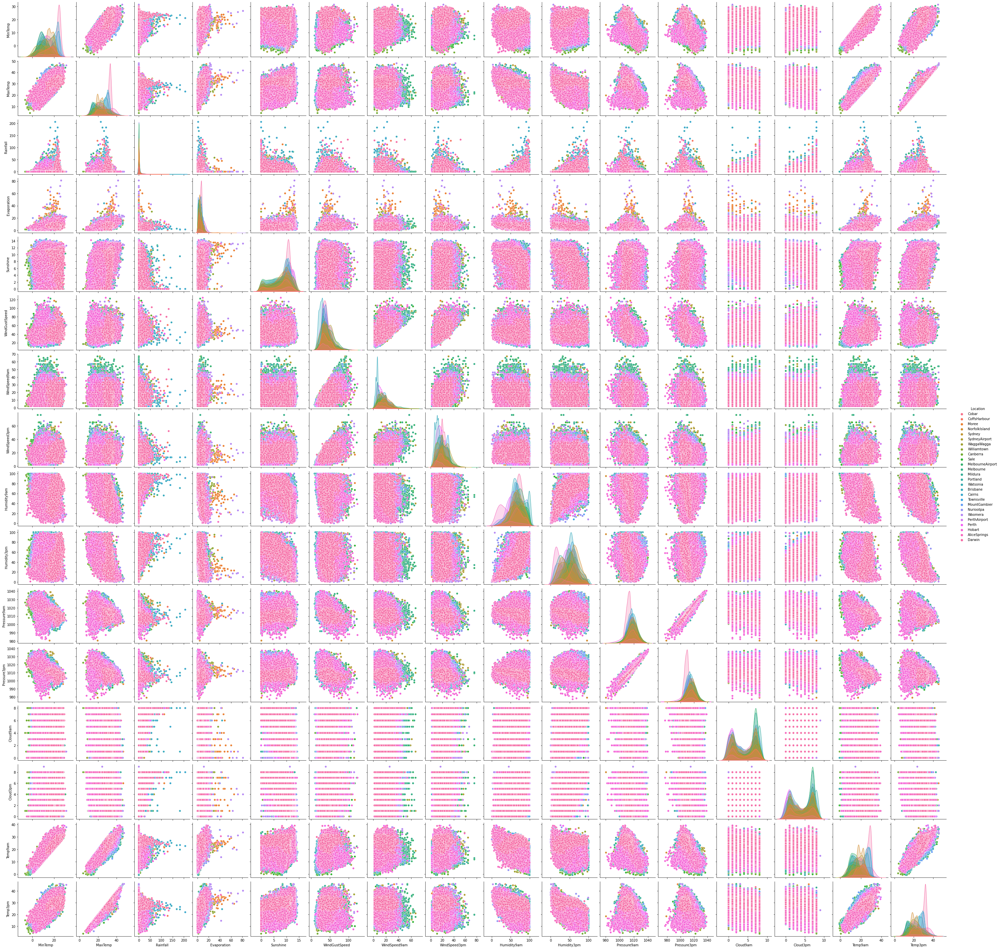

In [ ]:
sns.pairplot(df_nonans,hue = 'Location')

A su vez, podemos observar que día y en que lugar lloviío más mediante el atributo "rainfall". Para ello, fijaremos el indice de la tabla con la columna Date, la cual nos indica las fechas, y ordenaremos los datos de forma decreciente con el atributo "rainfall":

In [ ]:
df1 = pd.read_csv('/content/gdrive/MyDrive/data_course/Proyecto/weatherAUS.csv', index_col='Date')
df1.head(10)

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
Date,,,,,,,,,,,,,,,,,,,,,,
2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,WNW,20.0,24.0,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,WSW,4.0,22.0,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,WSW,19.0,26.0,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,E,11.0,9.0,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,NW,7.0,20.0,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No
2008-12-06,Albury,14.6,29.7,0.2,NaN,NaN,WNW,56.0,W,W,19.0,24.0,55.0,23.0,1009.2,1005.4,NaN,NaN,20.6,28.9,No,No
2008-12-07,Albury,14.3,25.0,0.0,NaN,NaN,W,50.0,SW,W,20.0,24.0,49.0,19.0,1009.6,1008.2,1.0,NaN,18.1,24.6,No,No
2008-12-08,Albury,7.7,26.7,0.0,NaN,NaN,W,35.0,SSE,W,6.0,17.0,48.0,19.0,1013.4,1010.1,NaN,NaN,16.3,25.5,No,No
2008-12-09,Albury,9.7,31.9,0.0,NaN,NaN,NNW,80.0,SE,NW,7.0,28.0,42.0,9.0,1008.9,1003.6,NaN,NaN,18.3,30.2,No,Yes


In [ ]:
df1.sort_values(by=['Rainfall'],ascending=False)

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
Date,,,,,,,,,,,,,,,,,,,,,,
2009-11-07,CoffsHarbour,17.4,23.1,371.0,NaN,3.5,NaN,NaN,SW,S,13.0,19.0,93.0,81.0,1026.6,1025.9,8.0,5.0,18.6,22.0,Yes,Yes
2011-02-16,Darwin,22.1,25.6,367.6,NaN,0.0,WSW,83.0,SSE,WSW,20.0,46.0,98.0,98.0,996.3,996.0,8.0,8.0,24.3,23.5,Yes,Yes
2009-01-12,Cairns,22.3,27.4,278.4,NaN,0.0,NW,59.0,SSE,NNW,17.0,11.0,96.0,98.0,1003.5,999.6,8.0,8.0,24.7,25.3,Yes,Yes
2011-02-04,Cairns,22.9,29.9,268.6,NaN,2.0,ENE,37.0,ENE,ENE,15.0,11.0,82.0,84.0,1011.1,1009.3,6.0,8.0,29.8,28.0,Yes,Yes
2015-02-08,Cairns,23.8,31.0,247.2,NaN,2.0,E,44.0,SSE,SE,17.0,28.0,100.0,74.0,1014.2,1011.4,8.0,8.0,25.3,30.0,Yes,Yes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2016-02-03,Uluru,20.6,32.6,NaN,NaN,NaN,S,39.0,SE,NE,24.0,13.0,50.0,32.0,1011.5,1008.7,NaN,NaN,22.6,30.0,NaN,No
2016-02-08,Uluru,23.8,38.3,NaN,NaN,NaN,NaN,NaN,ESE,ESE,17.0,26.0,27.0,16.0,1015.2,1010.8,NaN,NaN,30.6,36.1,NaN,No
2016-06-23,Uluru,14.2,18.7,NaN,NaN,NaN,NaN,NaN,W,NaN,9.0,NaN,81.0,67.0,1015.2,1014.6,8.0,8.0,16.6,17.5,NaN,NaN


2. Tras revisar el dataset y, con el fin de comenzar a tratar los datos, lo primera acción a realizar será ver el tipo de variables de las que disponemos, y eliminar de ellos los valores no numéricos, NaN's y boleanos, en el caso que hayan:

In [ ]:
df.dtypes

Date              object
Location          object
MinTemp          float64
MaxTemp          float64
Rainfall         float64
Evaporation      float64
Sunshine         float64
WindGustDir       object
WindGustSpeed    float64
WindDir9am        object
WindDir3pm        object
WindSpeed9am     float64
WindSpeed3pm     float64
Humidity9am      float64
Humidity3pm      float64
Pressure9am      float64
Pressure3pm      float64
Cloud9am         float64
Cloud3pm         float64
Temp9am          float64
Temp3pm          float64
RainToday         object
RainTomorrow      object
dtype: object

In [ ]:
df_num = df.select_dtypes(include='number') # keep only numeric variables 
df_num_nonans = df_num.dropna() # remove observations with NaNs
df_nonans = df.dropna() # remove observations with NaNs

print('datos originales = {}'.format(df.shape))
print('datos numericos = {}'.format(df_num.shape))
print('datos numericos sin NaNs = {}'.format(df_num_nonans.shape))
df_num_nonans.head(10)

datos originales = (145460, 23)
datos numericos = (145460, 16)
datos numericos sin NaNs = (58236, 16)


,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
6049,17.9,35.2,0.0,12.0,12.3,48.0,6.0,20.0,20.0,13.0,1006.3,1004.4,2.0,5.0,26.6,33.4
6050,18.4,28.9,0.0,14.8,13.0,37.0,19.0,19.0,30.0,8.0,1012.9,1012.1,1.0,1.0,20.3,27.0
6052,19.4,37.6,0.0,10.8,10.6,46.0,30.0,15.0,42.0,22.0,1012.3,1009.2,1.0,6.0,28.7,34.9
6053,21.9,38.4,0.0,11.4,12.2,31.0,6.0,6.0,37.0,22.0,1012.7,1009.1,1.0,5.0,29.1,35.6
6054,24.2,41.0,0.0,11.2,8.4,35.0,17.0,13.0,19.0,15.0,1010.7,1007.4,1.0,6.0,33.6,37.6
6055,27.1,36.1,0.0,13.0,0.0,43.0,7.0,20.0,26.0,19.0,1007.7,1007.4,8.0,8.0,30.7,34.3
6056,23.3,34.0,0.0,9.8,12.6,41.0,17.0,19.0,33.0,15.0,1011.3,1009.9,3.0,1.0,25.0,31.5
6057,16.1,34.2,0.0,14.6,13.2,37.0,15.0,6.0,25.0,9.0,1013.3,1009.2,1.0,1.0,20.7,32.8
6058,19.0,35.5,0.0,12.0,12.3,48.0,30.0,9.0,46.0,28.0,1008.3,1004.0,1.0,5.0,23.4,33.3
6059,19.7,35.5,0.0,11.0,12.7,41.0,15.0,17.0,61.0,14.0,1007.9,1005.8,1.0,5.0,24.0,33.6


Observamos que el número de atributos desciende de 23 a 16 (tal y como se ha podido observar, disponemos de 16 atibutos del tipo "Float" y 7 del tipo "Object". Además, al eliminar los NaN's, el numero de filas se reduce de 145.460 a 58.236.

Por otro lado, podemos observar que no disponemos de datos del tipo boleanos.

Con estos datos, podemos empezar a visualizar gráficas de ellos, como sería la cantidad de lluvia ("Rainfall") en función de si esta nublado, ya sea a las 9am o a las 3pm (Cloud9am & Cloud3pm):

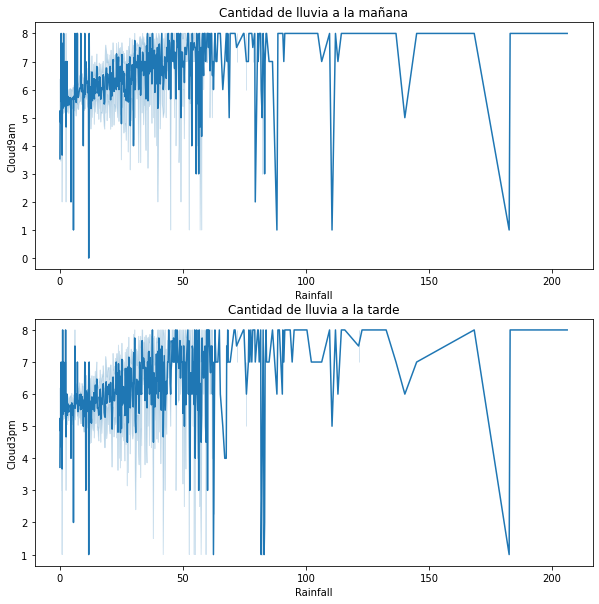

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

fig = plt.figure(figsize=(10,10))
ax = fig.add_subplot(211)
ax = sns.lineplot(x="Rainfall", y="Cloud9am", data=df_num_nonans)
ax.set_title('Cantidad de lluvia a la mañana')
ax1 = fig.add_subplot(212)
ax1 = sns.lineplot(x="Rainfall", y="Cloud3pm", data=df_num_nonans)
ax1.set_title('Cantidad de lluvia a la tarde')
plt.show()

Comp podemos observar, la cantidad de lluvia seuele encontrarse entre los 25 y 60 mm de agua al día, con fracciones de "oscuridad" de entre las 5 y los 7,5 octas (unidad de medida empleada para describir la nubosidad observable en un lugar, siendo 0 el mínimo y 8 el máximo).

Además, por otro lado, a continuación podemos observar la cantidad de lluvia en función de la cantidad de horas de sol que ha habido en un dia ("Sunshine") y guardar la imagen obtenida:

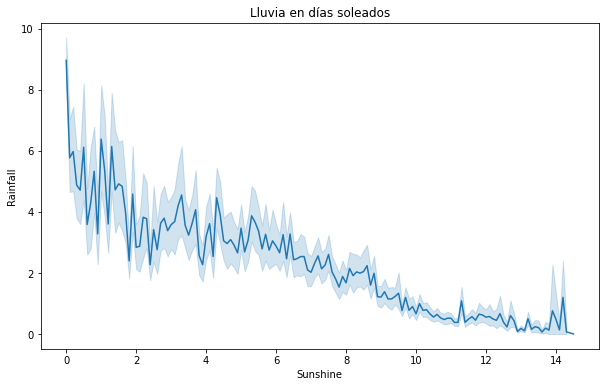

<Figure size 432x288 with 0 Axes>

In [ ]:
fig = plt.figure(figsize=(10,6))

ax = sns.lineplot(x="Sunshine", y="Rainfall", data=df_num_nonans)

ax.set_title('Lluvia en días soleados')
plt.show()
plt.savefig('Lluvia_DiasSoleados.png')


Como podemos observar, por lo general, en los días soleados la cantidad de precipitación en mm es inferior a 10, decreciendo de forma inversamente proporcional a la cantidad de horas de sol.

A continuación, podemos observar a nivel genérico la relación entre todos los distintos atributos del dataset:

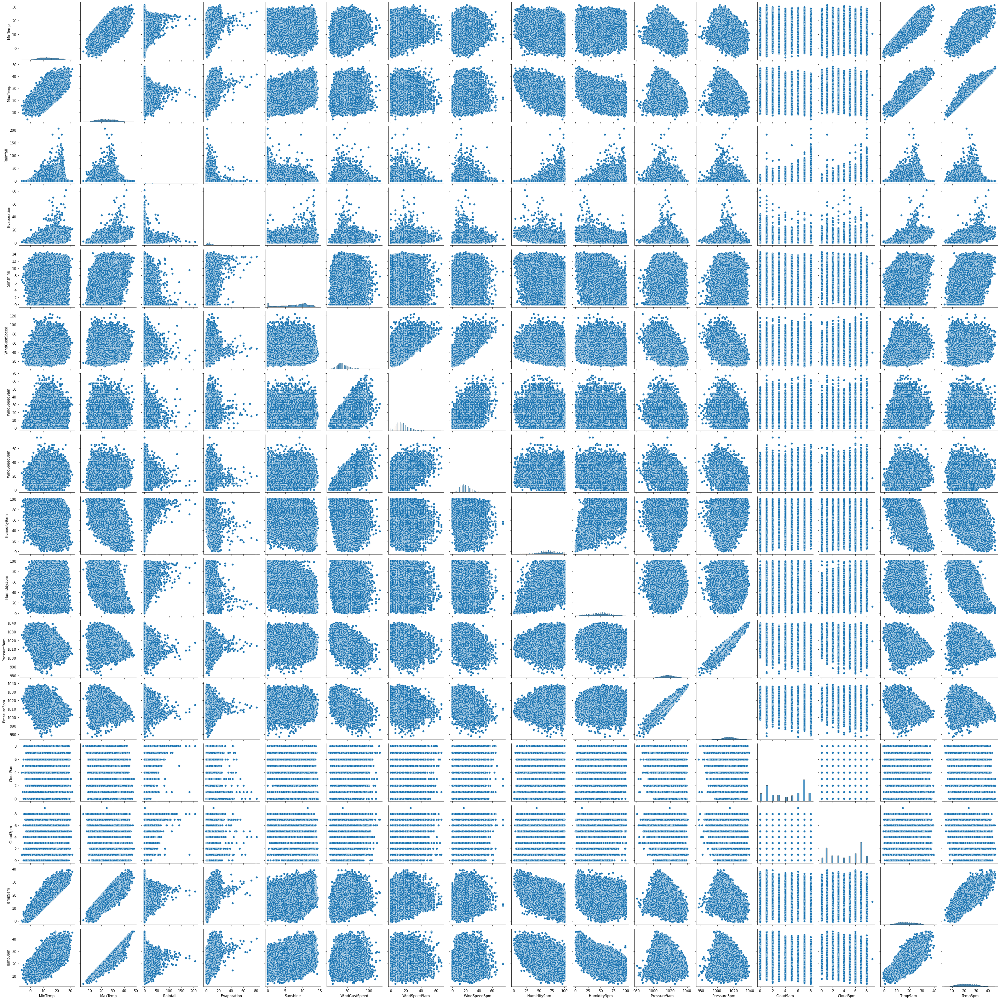

In [ ]:
sns.pairplot(df_num_nonans)

3. Reducción de dimensionalidad (PCA):

varianza explicada acumulada =[ 34.80269262  56.11314871  69.46623845  75.82381901  81.46302057
  86.10977826  89.10716401  91.68689078  94.13495156  96.07666535
  97.68990162  99.0291259   99.6025711   99.78634845  99.93709559
 100.        ]
Dimensionalidad datos en espacio PCA reducido = (58236, 10)


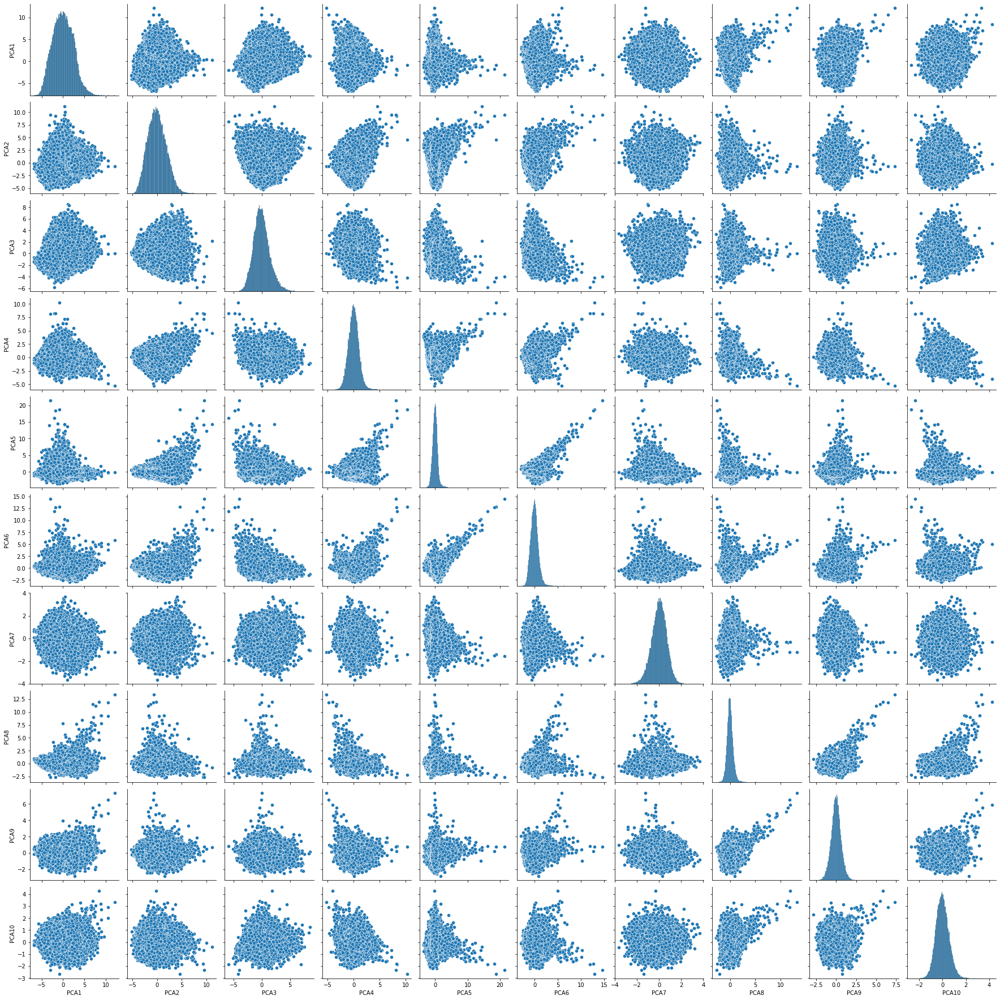

In [ ]:
import matplotlib.pylab as plt

X = df_num_nonans
y = df['Rainfall'] # use origin as class label (not needed in PCA)

# scale data:
from sklearn.preprocessing import StandardScaler
XS = StandardScaler().fit_transform(X)

# PCA decomopositon:
from sklearn import decomposition
n_variables = df_num_nonans.shape[1]
pca = decomposition.PCA(n_components=n_variables).fit(XS)

# varianza explicada acumulada:
print('varianza explicada acumulada ={}'.format(100*pca.explained_variance_ratio_.cumsum()))

# project data into PCA space:
Xproj = pca.transform(XS)

# Reducir dimensionalidad de los datos quedandonos solamente con tres componentes PCA:
ndim_reducida = 10 # establecer dimensionalidad reducida a partir de la varianza explicada por cada componente
XPCA = Xproj[:,0:ndim_reducida]

print('Dimensionalidad datos en espacio PCA reducido = {}'.format(XPCA.shape))

d = pd.DataFrame(XPCA,columns=['PCA1', 'PCA2', 'PCA3', 'PCA4', 'PCA5', 'PCA6', 'PCA7', 'PCA8', 'PCA9', 'PCA10'])
sns.pairplot(d)
plt.show()

4. Cluestering

4.1 k-means

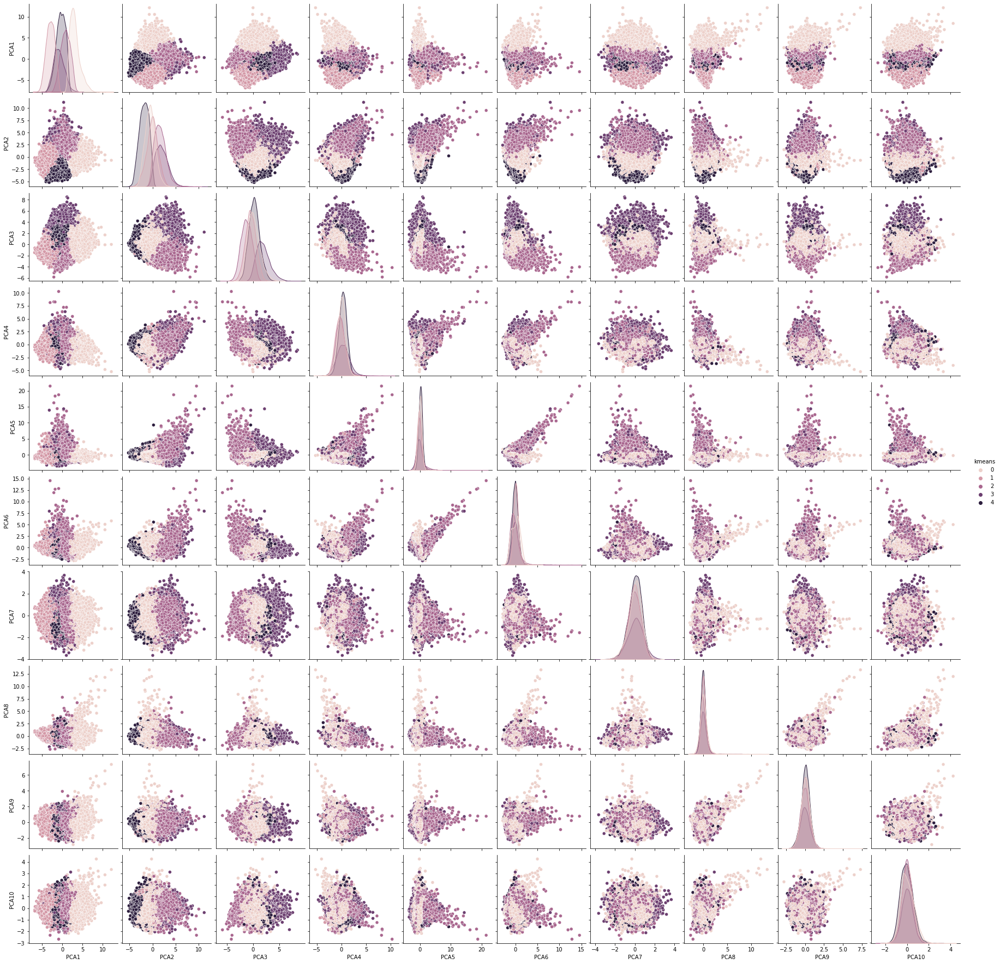

In [ ]:
from sklearn.cluster import KMeans
group = KMeans(n_clusters=5).fit_predict(d)

df_grouped = d.copy()
df_grouped['kmeans'] = group
g = sns.pairplot(df_grouped, hue="kmeans")

4.2 GMM + BIC

[5222738.3992097]
[5222738.3992097, 4566928.291865523]
[5222738.3992097, 4566928.291865523, 4508475.877371899]
[5222738.3992097, 4566928.291865523, 4508475.877371899, 4491101.759348721]
[5222738.3992097, 4566928.291865523, 4508475.877371899, 4491101.759348721, 4475135.538425175]
[5222738.3992097, 4566928.291865523, 4508475.877371899, 4491101.759348721, 4475135.538425175, 4431932.452174431]
[5222738.3992097, 4566928.291865523, 4508475.877371899, 4491101.759348721, 4475135.538425175, 4431932.452174431, 4421716.981708473]
[5222738.3992097, 4566928.291865523, 4508475.877371899, 4491101.759348721, 4475135.538425175, 4431932.452174431, 4421716.981708473, 4412074.613642651]
[5222738.3992097, 4566928.291865523, 4508475.877371899, 4491101.759348721, 4475135.538425175, 4431932.452174431, 4421716.981708473, 4412074.613642651, 4403275.634780434]
[5222738.3992097, 4566928.291865523, 4508475.877371899, 4491101.759348721, 4475135.538425175, 4431932.452174431, 4421716.981708473, 4412074.613642651, 440

<Figure size 864x432 with 0 Axes>

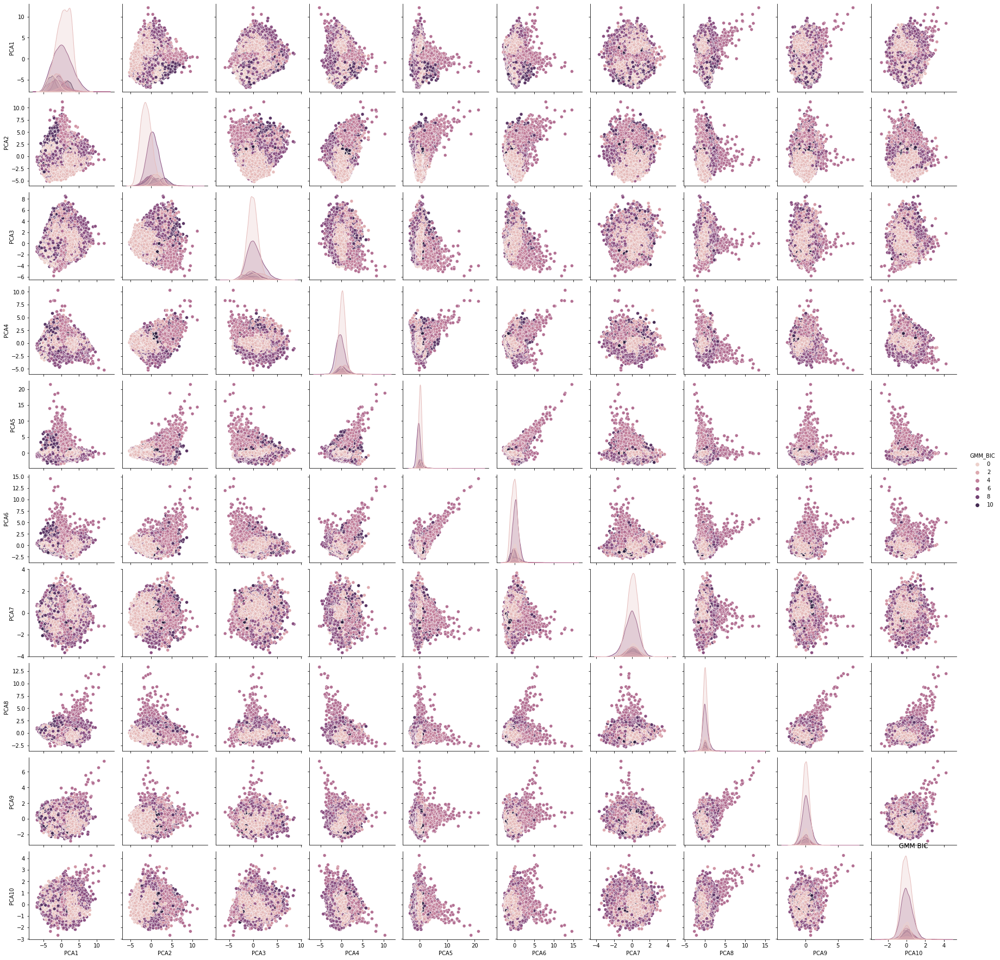

In [ ]:
from sklearn.datasets import make_blobs
import numpy as np
import seaborn as sns
from sklearn import mixture
import matplotlib.pyplot as plt

df_grouped2 = d.copy()
NMAX = 13
bic = []
for kG in np.arange(1,NMAX+1):
    gmm = mixture.GaussianMixture(n_components=kG,covariance_type='full').fit(X)
    bic.append(gmm.bic(X))
    print(bic)

idx_winner = np.argmin(bic)
print('...and the winner is GMM model G = {}'.format(idx_winner+1))
gmm = mixture.GaussianMixture(n_components=idx_winner+1,covariance_type='full').fit(X)

y_pred_gmm = gmm.fit_predict(X)

df_grouped2['GMM_BIC'] = y_pred_gmm

fig = plt.figure(figsize=(12,6))
sns.pairplot(df_grouped2,hue='GMM_BIC')
plt.title("GMM BIC")
plt.show()